# Face Generation

In this project, you'll define and train a Generative Adverserial network of your own creation on a dataset of faces. Your goal is to get a generator network to generate *new* images of faces that look as realistic as possible!

The project will be broken down into a series of tasks from **defining new architectures training adversarial networks**. At the end of the notebook, you'll be able to visualize the results of your trained Generator to see how it performs; your generated samples should look like fairly realistic faces with small amounts of noise.

### Get the Data

You'll be using the [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) to train your adversarial networks.

This dataset has higher resolution images than datasets you have previously worked with (like MNIST or SVHN) you've been working with, and so, you should prepare to define deeper networks and train them for a longer time to get good results. It is suggested that you utilize a GPU for training.

### Pre-processed Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. Some sample data is show below.

<img src='assets/processed_face_data.png' width=60% />

> If you are working locally, you can download this data [by clicking here](https://s3.amazonaws.com/video.udacity-data.com/topher/2018/November/5be7eb6f_processed-celeba-small/processed-celeba-small.zip)

This is a zip file that you'll need to extract in the home directory of this notebook for further loading and processing. After extracting the data, you should be left with a directory of data `processed-celeba-small/`.

In [1]:
# run this once to unzip the file
!unzip processed-celeba-small.zip

Archive:  processed-celeba-small.zip
   creating: processed_celeba_small/
  inflating: processed_celeba_small/.DS_Store  
   creating: __MACOSX/
   creating: __MACOSX/processed_celeba_small/
  inflating: __MACOSX/processed_celeba_small/._.DS_Store  
   creating: processed_celeba_small/celeba/
  inflating: processed_celeba_small/celeba/.DS_Store  
   creating: __MACOSX/processed_celeba_small/celeba/
  inflating: __MACOSX/processed_celeba_small/celeba/._.DS_Store  
  inflating: processed_celeba_small/celeba/161979.jpg  
  inflating: processed_celeba_small/celeba/161980.jpg  
  inflating: processed_celeba_small/celeba/161981.jpg  
  inflating: processed_celeba_small/celeba/161982.jpg  
  inflating: processed_celeba_small/celeba/161983.jpg  
  inflating: processed_celeba_small/celeba/161984.jpg  
  inflating: processed_celeba_small/celeba/161985.jpg  
  inflating: processed_celeba_small/celeba/161986.jpg  
  inflating: processed_celeba_small/celeba/161987.jpg  
  inflating: processed_celeb

In [1]:
from glob import glob
from typing import Tuple, Callable, Dict

import matplotlib.pyplot as plt
import numpy as np
import torch
from PIL import Image
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import Compose, ToTensor, Normalize, Resize

import tests

In [2]:
data_dir = 'processed_celeba_small/celeba/'

## Data pipeline

The [CelebA](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations. Since you're going to be generating faces, you won't need the annotations, you'll only need the images. Note that these are color images with [3 color channels (RGB)](https://en.wikipedia.org/wiki/Channel_(digital_image)#RGB_Images) each.

### Pre-process and Load the Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. This *pre-processed* dataset is a smaller subset of the very large CelebA dataset and contains roughly 30,000 images. 

Your first task consists in building the dataloader. To do so, you need to do the following:
* implement the get_transforms function
* create a custom Dataset class that reads the CelebA data

### Exercise: implement the get_transforms function

The `get_transforms` function should output a [`torchvision.transforms.Compose`](https://pytorch.org/vision/stable/generated/torchvision.transforms.Compose.html#torchvision.transforms.Compose) of different transformations. You have two constraints:
* the function takes a tuple of size as input and should **resize the images** to the input size
* the output images should have values **ranging from -1 to 1**

In [3]:
def get_transforms(size: Tuple[int, int]) -> Callable:
    """ Transforms to apply to the image."""
    # TODO: edit this function by appening transforms to the below list
    transforms = [Resize(size), ToTensor(), Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])]
    
    return Compose(transforms)

### Exercise: implement the DatasetDirectory class


The `DatasetDirectory` class is a torch Dataset that reads from the above data directory. The `__getitem__` method should output a transformed tensor and the `__len__` method should output the number of files in our dataset. You can look at [this custom dataset](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html#creating-a-custom-dataset-for-your-files) for ideas. 

In [4]:
class DatasetDirectory(Dataset):
    """
    A custom dataset class that loads images from folder.
    args:
    - directory: location of the images
    - transform: transform function to apply to the images
    - extension: file format
    """
    def __init__(self, 
                 directory: str, 
                 transforms: Callable = None, 
                 extension: str = '.jpg'):
        self.data_list = glob(data_dir + "*jpg")
        self.transforms = transforms
        
        
    def __len__(self) -> int:
        """ returns the number of items in the dataset """
        # TODO: return the number of elements in the dataset
        return len(self.data_list)

    def __getitem__(self, index: int) -> torch.Tensor:
        """ load an image and apply transformation """
        # TODO: return the index-element of the dataset
        image = Image.open(self.data_list[index])
        if self.transforms:
            image = self.transforms(image)
        return image

In [5]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your dataset implementation
dataset = DatasetDirectory(data_dir, get_transforms((64, 64)))
tests.check_dataset_outputs(dataset)

Congrats, your dataset implementation passed all the tests


The functions below will help you visualize images from the dataset.

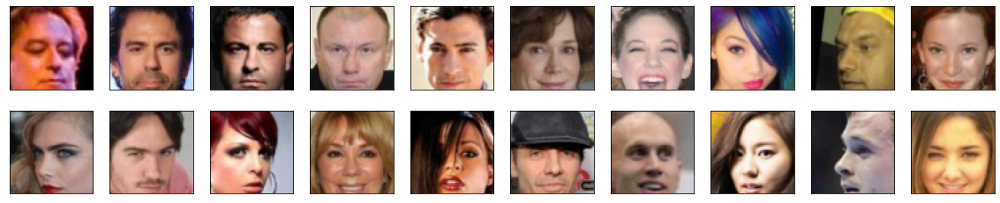

In [6]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def denormalize(images):
    """Transform images from [-1.0, 1.0] to [0, 255] and cast them to uint8."""
    return ((images + 1.) / 2. * 255).astype(np.uint8)

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(20, 4))
plot_size=20
for idx in np.arange(plot_size):
    ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
    img = dataset[idx].numpy()
    img = np.transpose(img, (1, 2, 0))
    img = denormalize(img)
    ax.imshow(img)

## Model implementation

As you know, a GAN is comprised of two adversarial networks, a discriminator and a generator. Now that we have a working data pipeline, we need to implement the discriminator and the generator. 

Feel free to implement any additional class or function.

### Exercise: Create the discriminator

The discriminator's job is to score real and fake images. You have two constraints here:
* the discriminator takes as input a **batch of 64x64x3 images**
* the output should be a single value (=score)

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips
* To scale down from the input image, you can either use `Conv2d` layers with the correct hyperparameters or Pooling layers.
* If you plan on using gradient penalty, do not use Batch Normalization layers in the discriminator.

In [7]:
from torch import nn
from torch.nn import Module
from torch.nn.utils import spectral_norm

In [8]:
# Discriminator with spectral normalization
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.model = nn.Sequential(
            spectral_norm(nn.Conv2d(3, 64, 4, 2, 1)),  # 64x64 → 32x32
            nn.LeakyReLU(0.2),
            spectral_norm(nn.Conv2d(64, 128, 4, 2, 1)), # 32x32 → 16x16
            nn.LeakyReLU(0.2),
            spectral_norm(nn.Conv2d(128, 256, 4, 2, 1)),# 16x16 → 8x8
            nn.LeakyReLU(0.2),
            spectral_norm(nn.Conv2d(256, 512, 4, 2, 1)),# 8x8 → 4x4
            nn.LeakyReLU(0.2),
            spectral_norm(nn.Conv2d(512, 1, 4, 1, 0))    # 4x4 → 1x1
        )

    def forward(self, x):
        out = self.model(x)
        return out


In [9]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to check your discriminator implementation
discriminator = Discriminator()
tests.check_discriminator(discriminator)

Congrats, your discriminator implementation passed all the tests


### Exercise: create the generator

The generator's job creates the "fake images" and learns the dataset distribution. You have three constraints here:
* the generator takes as input a vector of dimension `[batch_size, latent_dimension, 1, 1]`
* the generator must outputs **64x64x3 images**

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips:
* to scale up from the latent vector input, you can use `ConvTranspose2d` layers
* as often with Gan, **Batch Normalization** helps with training

In [10]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn.utils import spectral_norm


def normalize(z, eps=1e-8):
    return z / (z.norm(dim=1, keepdim=True) + eps)


class MappingNetwork(nn.Module):
    def __init__(self, latent_dim=128, depth=4):
        super().__init__()
        layers = []
        for _ in range(depth):
            layers.append(nn.Linear(latent_dim, latent_dim))
            layers.append(nn.LeakyReLU(0.2))
        self.mapping = nn.Sequential(*layers)

    def forward(self, z):
        z = normalize(z)
        return self.mapping(z.view(z.size(0), -1))

class AdaptiveInstanceNorm(nn.Module):
    def __init__(self, channels, style_dim):
        super().__init__()
        self.norm = nn.InstanceNorm2d(channels)
        self.style_scale = nn.Linear(style_dim, channels)
        self.style_shift = nn.Linear(style_dim, channels)

    def forward(self, x, style):
        normed = self.norm(x)
        scale = self.style_scale(style).unsqueeze(2).unsqueeze(3)
        shift = self.style_shift(style).unsqueeze(2).unsqueeze(3)
        return scale * normed + shift


class NoiseInjection(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.weight = nn.Parameter(torch.zeros(1, channels, 1, 1))

    def forward(self, x, noise=None):
        if noise is None:
            noise = torch.randn(x.size(0), 1, x.size(2), x.size(3), device=x.device)
        return x + self.weight * noise

# Modulated Conv2d (style modulated convolution)
class ModulatedConv2d(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, style_dim, demodulate=True):
        super().__init__()
        self.eps = 1e-8
        self.kernel_size = kernel_size
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.demodulate = demodulate

        self.weight = nn.Parameter(
            torch.randn(1, out_channels, in_channels, kernel_size, kernel_size)
        )
        self.style = nn.Linear(style_dim, in_channels)

    def forward(self, x, style):
        B, _, H, W = x.shape
        style = self.style(style).view(B, 1, self.in_channels, 1, 1)
        weight = self.weight * style

        if self.demodulate:
            demod = torch.rsqrt((weight ** 2).sum([2, 3, 4]) + self.eps)  
            weight = weight * demod.view(B, self.out_channels, 1, 1, 1)

        x = x.view(1, -1, H, W)
        weight = weight.view(-1, self.in_channels, self.kernel_size, self.kernel_size)
        out = F.conv2d(x, weight, padding=self.kernel_size // 2, groups=B)
        return out.view(B, self.out_channels, H, W)

# Styled convolutional block
class StyledConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels, style_dim, upsample=True):
        super().__init__()
        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False) if upsample else None
        self.modconv = ModulatedConv2d(in_channels, out_channels, 3, style_dim)
        self.noise = NoiseInjection(out_channels)
        self.adain = AdaptiveInstanceNorm(out_channels, style_dim)
        self.activation = nn.LeakyReLU(0.2)

    def forward(self, x, style):
        if self.upsample:
            x = self.upsample(x)
        x = self.modconv(x, style)
        x = self.noise(x)
        x = self.adain(x, style)
        return self.activation(x)

# Generator with initial constant and styled blocks
class Generator(nn.Module):
    def __init__(self, style_dim=128):
        super().__init__()
        self.initial_const = nn.Parameter(torch.randn(1, 512, 4, 4))

        self.blocks = nn.ModuleList([
            StyledConvBlock(512, 256, style_dim),  # 8x8
            StyledConvBlock(256, 128, style_dim),  # 16x16
            StyledConvBlock(128, 64, style_dim),   # 32x32
            StyledConvBlock(64, 32, style_dim),    # 64x64
        ])

        self.to_rgb = nn.Sequential(
            nn.Conv2d(32, 3, 1),
            nn.Tanh()
        )

    def forward(self, w):
        w = w.view(w.size(0), -1)
        x = self.initial_const.repeat(w.size(0), 1, 1, 1)
        for block in self.blocks:
            x = block(x, w)
        return self.to_rgb(x)




In [11]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your generator implementation
latent_dim = 128
generator = Generator(latent_dim)
tests.check_generator(generator, latent_dim)

Congrats, your generator implementation passed all the tests


## Optimizer

In the following section, we create the optimizers for the generator and discriminator. You may want to experiment with different optimizers, learning rates and other hyperparameters as they tend to impact the output quality.

### Exercise: implement the optimizers

In [32]:
import torch.optim as optim


def create_optimizers(generator: Module, discriminator: Module):
    """ This function should return the optimizers of the generator and the discriminator """
    # TODO: implement the generator and discriminator optimizers
    g_optimizer = optim.Adam(generator.parameters(), lr=0.0009, betas = (0.0, 0.9))
    d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0001, betas = (0.0, 0.9))
    return g_optimizer, d_optimizer

## Losses implementation

In this section, we are going to implement the loss function for the generator and the discriminator. You can and should experiment with different loss function.

Some tips:
* You can choose the commonly used the binary cross entropy loss or select other losses we have discovered in the course, such as the Wasserstein distance.
* You may want to implement a gradient penalty function as discussed in the course. It is not required and the code will work whether you implement it or not.

### Exercise: implement the generator loss

The generator's goal is to get the discriminator to think its generated images (= "fake" images) are real.

In [33]:
def generator_loss(fake_logits):
    """
    StyleGAN generator loss (non-saturating):
    minimize -log(D(G(z))) ~ softplus(-fake_logits)
    """
    loss = F.softplus(-fake_logits).mean()
    return loss

### Exercise: implement the discriminator loss

We want the discriminator to give high scores to real images and low scores to fake ones and the discriminator loss should reflect that.

In [34]:
def discriminator_loss(real_logits, fake_logits):
    """
    StyleGAN discriminator loss (logistic):
    minimize log(1+exp(-D(x))) + log(1+exp(D(G(z))))
    implemented as softplus(-real_logits) + softplus(fake_logits)
    """
    loss_real = F.softplus(-real_logits).mean()
    loss_fake = F.softplus(fake_logits).mean()
    loss = loss_real + loss_fake
    return loss

### Exercise (Optional): Implement the gradient Penalty

In the course, we discussed the importance of gradient penalty in training certain types of Gans. Implementing this function is not required and depends on some of the design decision you made (discriminator architecture, loss functions).

In [35]:
from torch import autograd

def gradient_penalty(discriminator, real_images, r1_gamma=10):
    """
    R1 regularization for StyleGAN:
    Penalizes gradient norm squared of discriminator output w.r.t. real images.
    """
    real_images.requires_grad_(True)
    real_scores = discriminator(real_images)
    grad_real = autograd.grad(
        outputs=real_scores.sum(),
        inputs=real_images,
        create_graph=True
    )[0]

    grad_penalty = grad_real.pow(2).reshape(grad_real.size(0), -1).sum(1).mean()
    return (r1_gamma / 2) * grad_penalty


## Training


Training will involve alternating between training the discriminator and the generator. You'll use your functions real_loss and fake_loss to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function

### Exercise: implement the generator step and the discriminator step functions

Each function should do the following:
* calculate the loss
* backpropagate the gradient
* perform one optimizer step

In [36]:
def generator_step(batch_size: int, latent_dim: int) -> Dict:
    """ One training step of the generator using StyleGAN loss (including backward and optimizer step). """
    latent_vectors = torch.randn(batch_size, latent_dim, 1, 1, device=device)
    gen_output = generator(latent_vectors)
    logits = discriminator(gen_output)
    
    g_loss = generator_loss(logits)
    
    g_optimizer.zero_grad()
    g_loss.backward()
    g_optimizer.step()
    
    return {'loss': g_loss.detach()}


def discriminator_step(batch_size: int, latent_dim: int, real_images: torch.Tensor) -> Dict:
    """ One training step of the discriminator using StyleGAN loss + R1 penalty (including backward and optimizer step). """
    latent_vectors = torch.randn(batch_size, latent_dim, 1, 1, device=device)
    with torch.no_grad():
        gen_output = generator(latent_vectors)
    
    fake_logits = discriminator(gen_output)
    real_logits = discriminator(real_images)
    
    d_loss = discriminator_loss(real_logits, fake_logits)  # StyleGAN disc loss
    r1_penalty = gradient_penalty(discriminator, real_images, r1_gamma=10)
    d_loss = d_loss + r1_penalty
    
    d_optimizer.zero_grad()
    d_loss.backward()
    d_optimizer.step()
    
    return {'loss': d_loss.detach(), 'r1_penalty': r1_penalty.detach()}

### Main training loop

You don't have to implement anything here but you can experiment with different hyperparameters.

In [37]:
from datetime import datetime

In [38]:
# you can experiment with different dimensions of latent spaces
latent_dim = 128

# update to cpu if you do not have access to a gpu
device = 'cuda'

# number of epochs to train your model
n_epochs = 40

# number of images in each batch
batch_size = 64

In [39]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
print_every = 50

# Create optimizers for the discriminator D and generator G
generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)
def weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.Linear)):
        nn.init.xavier_uniform_(m.weight.data)
discriminator.apply(weights_init)
g_optimizer, d_optimizer = create_optimizers(generator, discriminator)

dataloader = DataLoader(dataset, 
                        batch_size=64, 
                        shuffle=True, 
                        num_workers=4, 
                        drop_last=True,
                        pin_memory=False)

In [40]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def display(fixed_latent_vector: torch.Tensor):
    """ helper function to display images during training """
    fig = plt.figure(figsize=(14, 4))
    plot_size = 16
    for idx in np.arange(plot_size):
        ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
        img = fixed_latent_vector[idx, ...].detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = denormalize(img)
        ax.imshow(img)
    plt.show()

### Exercise: implement the training strategy

You should experiment with different training strategies. For example:

* train the generator more often than the discriminator. 
* added noise to the input image
* use label smoothing

Implement with your training strategy below.

2025-05-16 09:24:01 | Epoch [1/40] | Batch 0/509 | d_loss: 1.2995 | g_loss: 0.6425
2025-05-16 09:24:38 | Epoch [1/40] | Batch 50/509 | d_loss: 0.5190 | g_loss: 2.7424
2025-05-16 09:25:15 | Epoch [1/40] | Batch 100/509 | d_loss: 0.5990 | g_loss: 2.6210
2025-05-16 09:25:51 | Epoch [1/40] | Batch 150/509 | d_loss: 0.6208 | g_loss: 2.2788
2025-05-16 09:26:28 | Epoch [1/40] | Batch 200/509 | d_loss: 0.5324 | g_loss: 2.2624
2025-05-16 09:27:05 | Epoch [1/40] | Batch 250/509 | d_loss: 0.5117 | g_loss: 2.6719
2025-05-16 09:27:42 | Epoch [1/40] | Batch 300/509 | d_loss: 0.5676 | g_loss: 2.3830
2025-05-16 09:28:19 | Epoch [1/40] | Batch 350/509 | d_loss: 0.6265 | g_loss: 2.5578
2025-05-16 09:28:55 | Epoch [1/40] | Batch 400/509 | d_loss: 0.5151 | g_loss: 2.5244
2025-05-16 09:29:32 | Epoch [1/40] | Batch 450/509 | d_loss: 0.6275 | g_loss: 2.3498
2025-05-16 09:30:09 | Epoch [1/40] | Batch 500/509 | d_loss: 0.6065 | g_loss: 2.0687


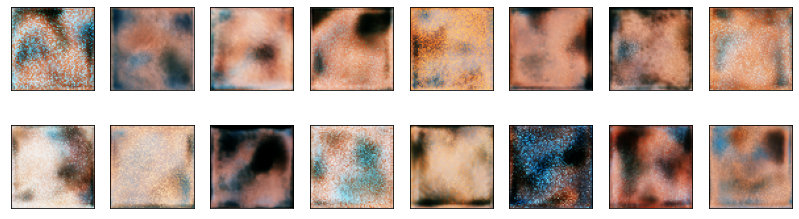

2025-05-16 09:30:19 | Epoch [2/40] | Batch 0/509 | d_loss: 0.4619 | g_loss: 2.2179
2025-05-16 09:30:56 | Epoch [2/40] | Batch 50/509 | d_loss: 0.6211 | g_loss: 2.6556
2025-05-16 09:31:33 | Epoch [2/40] | Batch 100/509 | d_loss: 0.5565 | g_loss: 2.4344
2025-05-16 09:32:10 | Epoch [2/40] | Batch 150/509 | d_loss: 0.5690 | g_loss: 2.3673
2025-05-16 09:32:47 | Epoch [2/40] | Batch 200/509 | d_loss: 0.5581 | g_loss: 2.3350
2025-05-16 09:33:23 | Epoch [2/40] | Batch 250/509 | d_loss: 0.5996 | g_loss: 2.1452
2025-05-16 09:34:00 | Epoch [2/40] | Batch 300/509 | d_loss: 0.6423 | g_loss: 2.1124
2025-05-16 09:34:37 | Epoch [2/40] | Batch 350/509 | d_loss: 0.5909 | g_loss: 2.3784
2025-05-16 09:35:14 | Epoch [2/40] | Batch 400/509 | d_loss: 0.6870 | g_loss: 2.2170
2025-05-16 09:35:50 | Epoch [2/40] | Batch 450/509 | d_loss: 0.5924 | g_loss: 2.1184
2025-05-16 09:36:27 | Epoch [2/40] | Batch 500/509 | d_loss: 0.6831 | g_loss: 2.2982


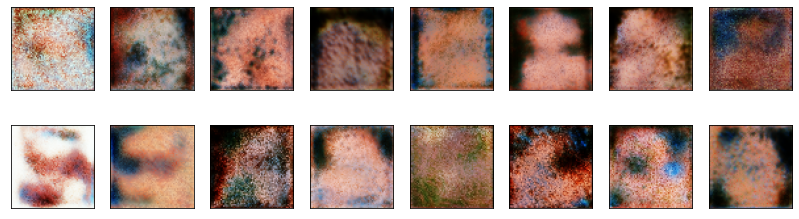

2025-05-16 09:36:37 | Epoch [3/40] | Batch 0/509 | d_loss: 0.6530 | g_loss: 2.2175
2025-05-16 09:37:14 | Epoch [3/40] | Batch 50/509 | d_loss: 0.6946 | g_loss: 2.0134
2025-05-16 09:37:51 | Epoch [3/40] | Batch 100/509 | d_loss: 0.7098 | g_loss: 1.8224
2025-05-16 09:38:28 | Epoch [3/40] | Batch 150/509 | d_loss: 0.7750 | g_loss: 1.6721
2025-05-16 09:39:04 | Epoch [3/40] | Batch 200/509 | d_loss: 0.8279 | g_loss: 1.7325
2025-05-16 09:39:41 | Epoch [3/40] | Batch 250/509 | d_loss: 0.8258 | g_loss: 1.7217
2025-05-16 09:40:18 | Epoch [3/40] | Batch 300/509 | d_loss: 0.8656 | g_loss: 1.4461
2025-05-16 09:40:55 | Epoch [3/40] | Batch 350/509 | d_loss: 0.7976 | g_loss: 1.3455
2025-05-16 09:41:32 | Epoch [3/40] | Batch 400/509 | d_loss: 0.8471 | g_loss: 1.4917
2025-05-16 09:42:08 | Epoch [3/40] | Batch 450/509 | d_loss: 0.8917 | g_loss: 1.5947
2025-05-16 09:42:45 | Epoch [3/40] | Batch 500/509 | d_loss: 0.8697 | g_loss: 1.5996


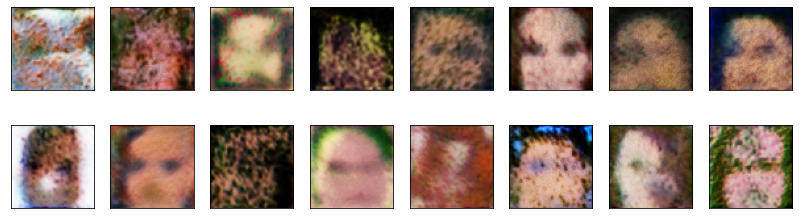

2025-05-16 09:42:56 | Epoch [4/40] | Batch 0/509 | d_loss: 0.9110 | g_loss: 1.5943
2025-05-16 09:43:33 | Epoch [4/40] | Batch 50/509 | d_loss: 0.8417 | g_loss: 1.6793
2025-05-16 09:44:10 | Epoch [4/40] | Batch 100/509 | d_loss: 0.9484 | g_loss: 1.3229
2025-05-16 09:44:47 | Epoch [4/40] | Batch 150/509 | d_loss: 0.8952 | g_loss: 1.3387
2025-05-16 09:45:23 | Epoch [4/40] | Batch 200/509 | d_loss: 0.9514 | g_loss: 1.4906
2025-05-16 09:46:00 | Epoch [4/40] | Batch 250/509 | d_loss: 0.9699 | g_loss: 1.5213
2025-05-16 09:46:37 | Epoch [4/40] | Batch 300/509 | d_loss: 0.9828 | g_loss: 1.3963
2025-05-16 09:47:14 | Epoch [4/40] | Batch 350/509 | d_loss: 1.0399 | g_loss: 1.4077
2025-05-16 09:47:51 | Epoch [4/40] | Batch 400/509 | d_loss: 0.9742 | g_loss: 0.9729
2025-05-16 09:48:27 | Epoch [4/40] | Batch 450/509 | d_loss: 0.9934 | g_loss: 1.4187
2025-05-16 09:49:04 | Epoch [4/40] | Batch 500/509 | d_loss: 0.9621 | g_loss: 1.4078


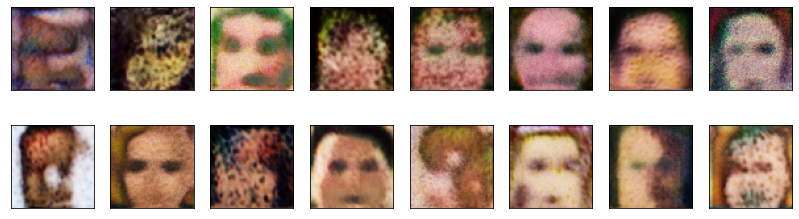

2025-05-16 09:49:15 | Epoch [5/40] | Batch 0/509 | d_loss: 0.9589 | g_loss: 1.2547
2025-05-16 09:49:52 | Epoch [5/40] | Batch 50/509 | d_loss: 0.9644 | g_loss: 1.2540
2025-05-16 09:50:28 | Epoch [5/40] | Batch 100/509 | d_loss: 0.9786 | g_loss: 1.2109
2025-05-16 09:51:05 | Epoch [5/40] | Batch 150/509 | d_loss: 1.0386 | g_loss: 1.3076
2025-05-16 09:51:42 | Epoch [5/40] | Batch 200/509 | d_loss: 1.0114 | g_loss: 1.3005
2025-05-16 09:52:19 | Epoch [5/40] | Batch 250/509 | d_loss: 1.0185 | g_loss: 1.1866
2025-05-16 09:52:55 | Epoch [5/40] | Batch 300/509 | d_loss: 0.9575 | g_loss: 1.3155
2025-05-16 09:53:32 | Epoch [5/40] | Batch 350/509 | d_loss: 1.0174 | g_loss: 1.2436
2025-05-16 09:54:09 | Epoch [5/40] | Batch 400/509 | d_loss: 0.9584 | g_loss: 1.1563
2025-05-16 09:54:46 | Epoch [5/40] | Batch 450/509 | d_loss: 1.0377 | g_loss: 1.2158
2025-05-16 09:55:23 | Epoch [5/40] | Batch 500/509 | d_loss: 1.0358 | g_loss: 1.2873


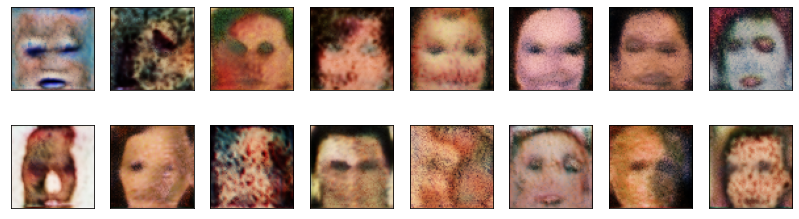

2025-05-16 09:55:33 | Epoch [6/40] | Batch 0/509 | d_loss: 1.0631 | g_loss: 1.1842
2025-05-16 09:56:10 | Epoch [6/40] | Batch 50/509 | d_loss: 1.0214 | g_loss: 1.2370
2025-05-16 09:56:47 | Epoch [6/40] | Batch 100/509 | d_loss: 1.0628 | g_loss: 1.2382
2025-05-16 09:57:24 | Epoch [6/40] | Batch 150/509 | d_loss: 1.0783 | g_loss: 1.2498
2025-05-16 09:58:00 | Epoch [6/40] | Batch 200/509 | d_loss: 1.0278 | g_loss: 1.1346
2025-05-16 09:58:37 | Epoch [6/40] | Batch 250/509 | d_loss: 1.0644 | g_loss: 1.2187
2025-05-16 09:59:14 | Epoch [6/40] | Batch 300/509 | d_loss: 1.0779 | g_loss: 1.3228
2025-05-16 09:59:51 | Epoch [6/40] | Batch 350/509 | d_loss: 1.0953 | g_loss: 1.2092
2025-05-16 10:00:28 | Epoch [6/40] | Batch 400/509 | d_loss: 1.0864 | g_loss: 1.2746
2025-05-16 10:01:04 | Epoch [6/40] | Batch 450/509 | d_loss: 1.0847 | g_loss: 1.1125
2025-05-16 10:01:41 | Epoch [6/40] | Batch 500/509 | d_loss: 1.1492 | g_loss: 1.1817


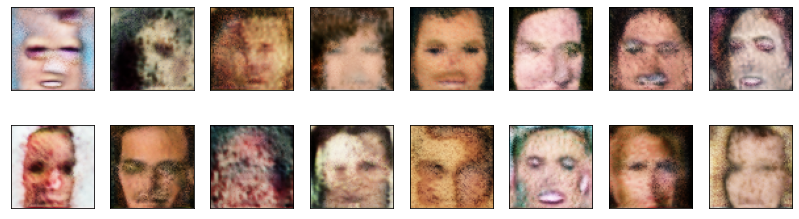

2025-05-16 10:01:51 | Epoch [7/40] | Batch 0/509 | d_loss: 1.0946 | g_loss: 1.1923
2025-05-16 10:02:28 | Epoch [7/40] | Batch 50/509 | d_loss: 1.1326 | g_loss: 1.1776
2025-05-16 10:03:05 | Epoch [7/40] | Batch 100/509 | d_loss: 1.1153 | g_loss: 1.1187
2025-05-16 10:03:42 | Epoch [7/40] | Batch 150/509 | d_loss: 1.1298 | g_loss: 1.1793
2025-05-16 10:04:19 | Epoch [7/40] | Batch 200/509 | d_loss: 1.0972 | g_loss: 1.1132
2025-05-16 10:04:55 | Epoch [7/40] | Batch 250/509 | d_loss: 1.1344 | g_loss: 1.1182
2025-05-16 10:05:32 | Epoch [7/40] | Batch 300/509 | d_loss: 1.1608 | g_loss: 1.0426
2025-05-16 10:06:09 | Epoch [7/40] | Batch 350/509 | d_loss: 1.1432 | g_loss: 1.0783
2025-05-16 10:06:46 | Epoch [7/40] | Batch 400/509 | d_loss: 1.1659 | g_loss: 1.0299
2025-05-16 10:07:23 | Epoch [7/40] | Batch 450/509 | d_loss: 1.1838 | g_loss: 1.0180
2025-05-16 10:07:59 | Epoch [7/40] | Batch 500/509 | d_loss: 1.1681 | g_loss: 0.9889


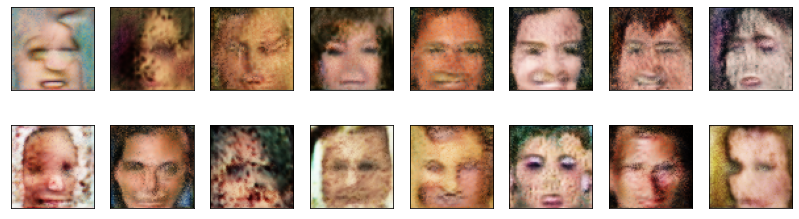

2025-05-16 10:08:09 | Epoch [8/40] | Batch 0/509 | d_loss: 1.1553 | g_loss: 1.0174
2025-05-16 10:08:46 | Epoch [8/40] | Batch 50/509 | d_loss: 1.2005 | g_loss: 1.1041
2025-05-16 10:09:23 | Epoch [8/40] | Batch 100/509 | d_loss: 1.1531 | g_loss: 1.0996
2025-05-16 10:10:00 | Epoch [8/40] | Batch 150/509 | d_loss: 1.1583 | g_loss: 0.9935
2025-05-16 10:10:36 | Epoch [8/40] | Batch 200/509 | d_loss: 1.1917 | g_loss: 1.0625
2025-05-16 10:11:13 | Epoch [8/40] | Batch 250/509 | d_loss: 1.2037 | g_loss: 1.0125
2025-05-16 10:11:50 | Epoch [8/40] | Batch 300/509 | d_loss: 1.1754 | g_loss: 0.9984
2025-05-16 10:12:27 | Epoch [8/40] | Batch 350/509 | d_loss: 1.1817 | g_loss: 0.9832
2025-05-16 10:13:04 | Epoch [8/40] | Batch 400/509 | d_loss: 1.2340 | g_loss: 1.0148
2025-05-16 10:13:41 | Epoch [8/40] | Batch 450/509 | d_loss: 1.1860 | g_loss: 0.9421
2025-05-16 10:14:17 | Epoch [8/40] | Batch 500/509 | d_loss: 1.1916 | g_loss: 1.0105


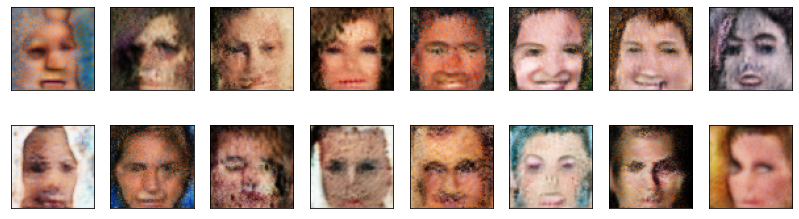

2025-05-16 10:14:28 | Epoch [9/40] | Batch 0/509 | d_loss: 1.2387 | g_loss: 1.0302
2025-05-16 10:15:05 | Epoch [9/40] | Batch 50/509 | d_loss: 1.2044 | g_loss: 0.9538
2025-05-16 10:15:42 | Epoch [9/40] | Batch 100/509 | d_loss: 1.2058 | g_loss: 0.9171
2025-05-16 10:16:19 | Epoch [9/40] | Batch 150/509 | d_loss: 1.2009 | g_loss: 0.9659
2025-05-16 10:16:56 | Epoch [9/40] | Batch 200/509 | d_loss: 1.2060 | g_loss: 0.9814
2025-05-16 10:17:33 | Epoch [9/40] | Batch 250/509 | d_loss: 1.2077 | g_loss: 0.9857
2025-05-16 10:18:09 | Epoch [9/40] | Batch 300/509 | d_loss: 1.1966 | g_loss: 0.9457
2025-05-16 10:18:46 | Epoch [9/40] | Batch 350/509 | d_loss: 1.2432 | g_loss: 0.9318
2025-05-16 10:19:23 | Epoch [9/40] | Batch 400/509 | d_loss: 1.1751 | g_loss: 0.9402
2025-05-16 10:20:00 | Epoch [9/40] | Batch 450/509 | d_loss: 1.2408 | g_loss: 0.9763
2025-05-16 10:20:37 | Epoch [9/40] | Batch 500/509 | d_loss: 1.1917 | g_loss: 0.9078


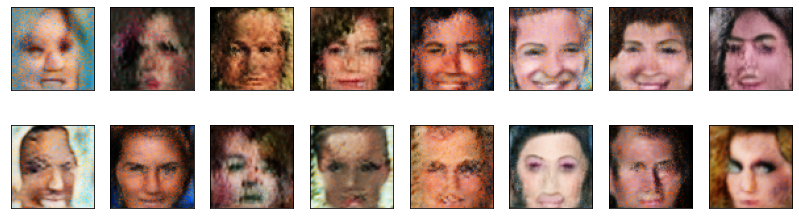

2025-05-16 10:20:47 | Epoch [10/40] | Batch 0/509 | d_loss: 1.2384 | g_loss: 0.7368
2025-05-16 10:21:23 | Epoch [10/40] | Batch 50/509 | d_loss: 1.2374 | g_loss: 0.9511
2025-05-16 10:22:00 | Epoch [10/40] | Batch 100/509 | d_loss: 1.2087 | g_loss: 0.9434
2025-05-16 10:22:37 | Epoch [10/40] | Batch 150/509 | d_loss: 1.2159 | g_loss: 0.9112
2025-05-16 10:23:14 | Epoch [10/40] | Batch 200/509 | d_loss: 1.2403 | g_loss: 0.8814
2025-05-16 10:23:51 | Epoch [10/40] | Batch 250/509 | d_loss: 1.2454 | g_loss: 0.9628
2025-05-16 10:24:28 | Epoch [10/40] | Batch 300/509 | d_loss: 1.2197 | g_loss: 0.9333
2025-05-16 10:25:04 | Epoch [10/40] | Batch 350/509 | d_loss: 1.2093 | g_loss: 0.8380
2025-05-16 10:25:41 | Epoch [10/40] | Batch 400/509 | d_loss: 1.2682 | g_loss: 0.9834
2025-05-16 10:26:18 | Epoch [10/40] | Batch 450/509 | d_loss: 1.2288 | g_loss: 0.8113
2025-05-16 10:26:55 | Epoch [10/40] | Batch 500/509 | d_loss: 1.2585 | g_loss: 0.9402


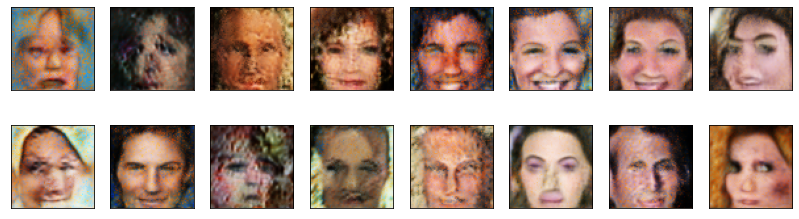

2025-05-16 10:27:05 | Epoch [11/40] | Batch 0/509 | d_loss: 1.2667 | g_loss: 0.8763
2025-05-16 10:27:42 | Epoch [11/40] | Batch 50/509 | d_loss: 1.2228 | g_loss: 0.7784
2025-05-16 10:28:19 | Epoch [11/40] | Batch 100/509 | d_loss: 1.2424 | g_loss: 0.9349
2025-05-16 10:28:56 | Epoch [11/40] | Batch 150/509 | d_loss: 1.2092 | g_loss: 0.8642
2025-05-16 10:29:32 | Epoch [11/40] | Batch 200/509 | d_loss: 1.2646 | g_loss: 0.8845
2025-05-16 10:30:09 | Epoch [11/40] | Batch 250/509 | d_loss: 1.2432 | g_loss: 0.8355
2025-05-16 10:30:46 | Epoch [11/40] | Batch 300/509 | d_loss: 1.2641 | g_loss: 0.8572
2025-05-16 10:31:23 | Epoch [11/40] | Batch 350/509 | d_loss: 1.2344 | g_loss: 0.9282
2025-05-16 10:32:00 | Epoch [11/40] | Batch 400/509 | d_loss: 1.2605 | g_loss: 0.8706
2025-05-16 10:32:37 | Epoch [11/40] | Batch 450/509 | d_loss: 1.2519 | g_loss: 0.8667
2025-05-16 10:33:13 | Epoch [11/40] | Batch 500/509 | d_loss: 1.2518 | g_loss: 0.8338


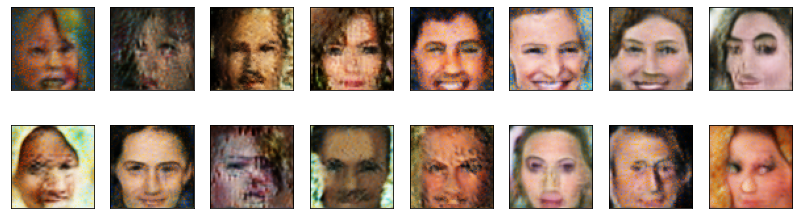

2025-05-16 10:33:23 | Epoch [12/40] | Batch 0/509 | d_loss: 1.2604 | g_loss: 0.9255
2025-05-16 10:34:00 | Epoch [12/40] | Batch 50/509 | d_loss: 1.2484 | g_loss: 0.8885
2025-05-16 10:34:37 | Epoch [12/40] | Batch 100/509 | d_loss: 1.2482 | g_loss: 0.8682
2025-05-16 10:35:13 | Epoch [12/40] | Batch 150/509 | d_loss: 1.2425 | g_loss: 0.8632
2025-05-16 10:35:50 | Epoch [12/40] | Batch 200/509 | d_loss: 1.2399 | g_loss: 0.9038
2025-05-16 10:36:27 | Epoch [12/40] | Batch 250/509 | d_loss: 1.2364 | g_loss: 0.8682
2025-05-16 10:37:04 | Epoch [12/40] | Batch 300/509 | d_loss: 1.2726 | g_loss: 0.8772
2025-05-16 10:37:40 | Epoch [12/40] | Batch 350/509 | d_loss: 1.2526 | g_loss: 0.8694
2025-05-16 10:38:18 | Epoch [12/40] | Batch 400/509 | d_loss: 1.2456 | g_loss: 0.8406
2025-05-16 10:38:54 | Epoch [12/40] | Batch 450/509 | d_loss: 1.2717 | g_loss: 0.9057
2025-05-16 10:39:31 | Epoch [12/40] | Batch 500/509 | d_loss: 1.2755 | g_loss: 0.9045


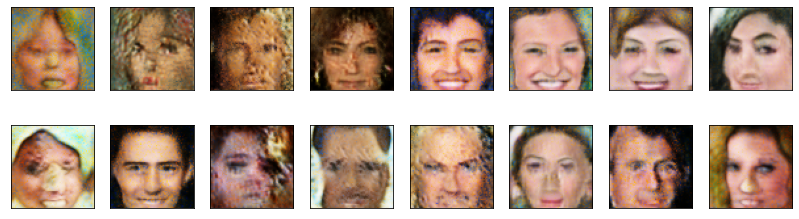

2025-05-16 10:39:41 | Epoch [13/40] | Batch 0/509 | d_loss: 1.2620 | g_loss: 0.8630
2025-05-16 10:40:18 | Epoch [13/40] | Batch 50/509 | d_loss: 1.2777 | g_loss: 0.9501
2025-05-16 10:40:55 | Epoch [13/40] | Batch 100/509 | d_loss: 1.2469 | g_loss: 0.8006
2025-05-16 10:41:32 | Epoch [13/40] | Batch 150/509 | d_loss: 1.2770 | g_loss: 0.6560
2025-05-16 10:42:09 | Epoch [13/40] | Batch 200/509 | d_loss: 1.2503 | g_loss: 0.9366
2025-05-16 10:42:46 | Epoch [13/40] | Batch 250/509 | d_loss: 1.2761 | g_loss: 0.8833
2025-05-16 10:43:22 | Epoch [13/40] | Batch 300/509 | d_loss: 1.2306 | g_loss: 0.8479
2025-05-16 10:43:59 | Epoch [13/40] | Batch 350/509 | d_loss: 1.2763 | g_loss: 0.9136
2025-05-16 10:44:36 | Epoch [13/40] | Batch 400/509 | d_loss: 1.2544 | g_loss: 0.8690
2025-05-16 10:45:13 | Epoch [13/40] | Batch 450/509 | d_loss: 1.2692 | g_loss: 0.8655
2025-05-16 10:45:50 | Epoch [13/40] | Batch 500/509 | d_loss: 1.2489 | g_loss: 0.7772


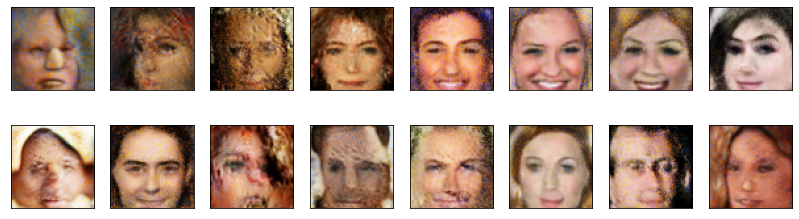

2025-05-16 10:46:01 | Epoch [14/40] | Batch 0/509 | d_loss: 1.2547 | g_loss: 0.9055
2025-05-16 10:46:38 | Epoch [14/40] | Batch 50/509 | d_loss: 1.2617 | g_loss: 0.7721
2025-05-16 10:47:15 | Epoch [14/40] | Batch 100/509 | d_loss: 1.2554 | g_loss: 0.8779
2025-05-16 10:47:51 | Epoch [14/40] | Batch 150/509 | d_loss: 1.2615 | g_loss: 0.9065
2025-05-16 10:48:28 | Epoch [14/40] | Batch 200/509 | d_loss: 1.2733 | g_loss: 0.8572
2025-05-16 10:49:05 | Epoch [14/40] | Batch 250/509 | d_loss: 1.2482 | g_loss: 0.8685
2025-05-16 10:49:42 | Epoch [14/40] | Batch 300/509 | d_loss: 1.2554 | g_loss: 0.9265
2025-05-16 10:50:19 | Epoch [14/40] | Batch 350/509 | d_loss: 1.2751 | g_loss: 0.8218
2025-05-16 10:50:55 | Epoch [14/40] | Batch 400/509 | d_loss: 1.2857 | g_loss: 0.8296
2025-05-16 10:51:32 | Epoch [14/40] | Batch 450/509 | d_loss: 1.2772 | g_loss: 0.8648
2025-05-16 10:52:09 | Epoch [14/40] | Batch 500/509 | d_loss: 1.2575 | g_loss: 0.8718


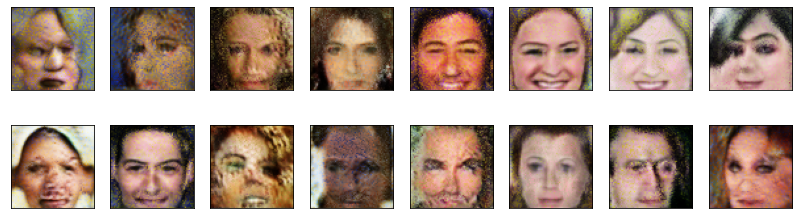

2025-05-16 10:52:19 | Epoch [15/40] | Batch 0/509 | d_loss: 1.2826 | g_loss: 0.8450
2025-05-16 10:52:55 | Epoch [15/40] | Batch 50/509 | d_loss: 1.2409 | g_loss: 0.7939
2025-05-16 10:53:32 | Epoch [15/40] | Batch 100/509 | d_loss: 1.2758 | g_loss: 0.8300
2025-05-16 10:54:09 | Epoch [15/40] | Batch 150/509 | d_loss: 1.2688 | g_loss: 0.8439
2025-05-16 10:54:46 | Epoch [15/40] | Batch 200/509 | d_loss: 1.2572 | g_loss: 0.8380
2025-05-16 10:55:23 | Epoch [15/40] | Batch 250/509 | d_loss: 1.2678 | g_loss: 0.8173
2025-05-16 10:56:00 | Epoch [15/40] | Batch 300/509 | d_loss: 1.2669 | g_loss: 0.8938
2025-05-16 10:56:36 | Epoch [15/40] | Batch 350/509 | d_loss: 1.2518 | g_loss: 0.7948
2025-05-16 10:57:13 | Epoch [15/40] | Batch 400/509 | d_loss: 1.2868 | g_loss: 0.8428
2025-05-16 10:57:50 | Epoch [15/40] | Batch 450/509 | d_loss: 1.3054 | g_loss: 0.8577
2025-05-16 10:58:27 | Epoch [15/40] | Batch 500/509 | d_loss: 1.2723 | g_loss: 0.8233


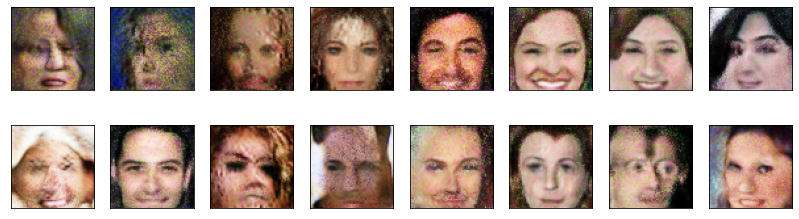

2025-05-16 10:58:36 | Epoch [16/40] | Batch 0/509 | d_loss: 1.2445 | g_loss: 0.8452
2025-05-16 10:59:13 | Epoch [16/40] | Batch 50/509 | d_loss: 1.2604 | g_loss: 0.8789
2025-05-16 10:59:50 | Epoch [16/40] | Batch 100/509 | d_loss: 1.2860 | g_loss: 0.8669
2025-05-16 11:00:26 | Epoch [16/40] | Batch 150/509 | d_loss: 1.2997 | g_loss: 0.8603
2025-05-16 11:01:03 | Epoch [16/40] | Batch 200/509 | d_loss: 1.2692 | g_loss: 0.7895
2025-05-16 11:01:40 | Epoch [16/40] | Batch 250/509 | d_loss: 1.2816 | g_loss: 0.9250
2025-05-16 11:02:17 | Epoch [16/40] | Batch 300/509 | d_loss: 1.2893 | g_loss: 0.8667
2025-05-16 11:02:54 | Epoch [16/40] | Batch 350/509 | d_loss: 1.2793 | g_loss: 0.8083
2025-05-16 11:03:30 | Epoch [16/40] | Batch 400/509 | d_loss: 1.2854 | g_loss: 0.8344
2025-05-16 11:04:07 | Epoch [16/40] | Batch 450/509 | d_loss: 1.2594 | g_loss: 0.8096
2025-05-16 11:04:44 | Epoch [16/40] | Batch 500/509 | d_loss: 1.2761 | g_loss: 0.7925


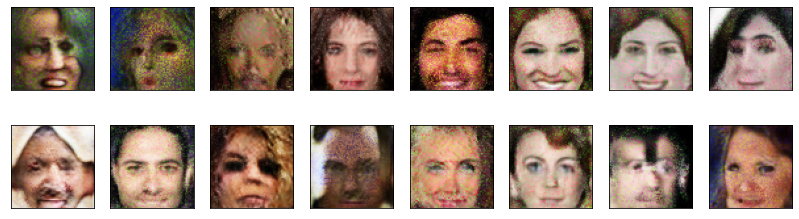

2025-05-16 11:04:54 | Epoch [17/40] | Batch 0/509 | d_loss: 1.2723 | g_loss: 0.8236
2025-05-16 11:05:31 | Epoch [17/40] | Batch 50/509 | d_loss: 1.2694 | g_loss: 0.8359
2025-05-16 11:06:08 | Epoch [17/40] | Batch 100/509 | d_loss: 1.2534 | g_loss: 0.9101
2025-05-16 11:06:44 | Epoch [17/40] | Batch 150/509 | d_loss: 1.2874 | g_loss: 0.8131
2025-05-16 11:07:21 | Epoch [17/40] | Batch 200/509 | d_loss: 1.2710 | g_loss: 0.7823
2025-05-16 11:07:58 | Epoch [17/40] | Batch 250/509 | d_loss: 1.2689 | g_loss: 0.8162
2025-05-16 11:08:35 | Epoch [17/40] | Batch 300/509 | d_loss: 1.2574 | g_loss: 0.8257
2025-05-16 11:09:12 | Epoch [17/40] | Batch 350/509 | d_loss: 1.2643 | g_loss: 0.8068
2025-05-16 11:09:48 | Epoch [17/40] | Batch 400/509 | d_loss: 1.2783 | g_loss: 0.8891
2025-05-16 11:10:25 | Epoch [17/40] | Batch 450/509 | d_loss: 1.3006 | g_loss: 0.8121
2025-05-16 11:11:02 | Epoch [17/40] | Batch 500/509 | d_loss: 1.2908 | g_loss: 0.8803


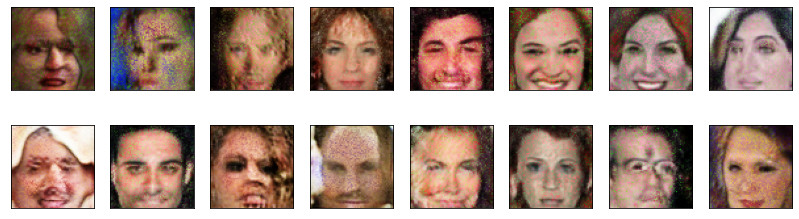

2025-05-16 11:11:12 | Epoch [18/40] | Batch 0/509 | d_loss: 1.2801 | g_loss: 0.7433
2025-05-16 11:11:49 | Epoch [18/40] | Batch 50/509 | d_loss: 1.2527 | g_loss: 0.7912
2025-05-16 11:12:26 | Epoch [18/40] | Batch 100/509 | d_loss: 1.2781 | g_loss: 0.7527
2025-05-16 11:13:02 | Epoch [18/40] | Batch 150/509 | d_loss: 1.3094 | g_loss: 0.8348
2025-05-16 11:13:39 | Epoch [18/40] | Batch 200/509 | d_loss: 1.2780 | g_loss: 0.8098
2025-05-16 11:14:16 | Epoch [18/40] | Batch 250/509 | d_loss: 1.2878 | g_loss: 0.8417
2025-05-16 11:14:53 | Epoch [18/40] | Batch 300/509 | d_loss: 1.2848 | g_loss: 0.8357
2025-05-16 11:15:30 | Epoch [18/40] | Batch 350/509 | d_loss: 1.2969 | g_loss: 0.9086
2025-05-16 11:16:07 | Epoch [18/40] | Batch 400/509 | d_loss: 1.2969 | g_loss: 0.8174
2025-05-16 11:16:43 | Epoch [18/40] | Batch 450/509 | d_loss: 1.3036 | g_loss: 0.8330
2025-05-16 11:17:20 | Epoch [18/40] | Batch 500/509 | d_loss: 1.2810 | g_loss: 0.8227


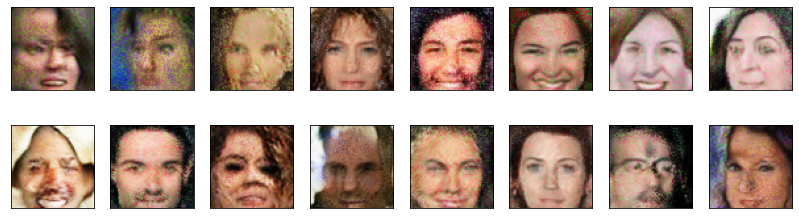

2025-05-16 11:17:30 | Epoch [19/40] | Batch 0/509 | d_loss: 1.2922 | g_loss: 0.8018
2025-05-16 11:18:07 | Epoch [19/40] | Batch 50/509 | d_loss: 1.2869 | g_loss: 0.7425
2025-05-16 11:18:44 | Epoch [19/40] | Batch 100/509 | d_loss: 1.2588 | g_loss: 0.8116
2025-05-16 11:19:20 | Epoch [19/40] | Batch 150/509 | d_loss: 1.2928 | g_loss: 0.7980
2025-05-16 11:19:57 | Epoch [19/40] | Batch 200/509 | d_loss: 1.3049 | g_loss: 0.7807
2025-05-16 11:20:34 | Epoch [19/40] | Batch 250/509 | d_loss: 1.2828 | g_loss: 0.7942
2025-05-16 11:21:11 | Epoch [19/40] | Batch 300/509 | d_loss: 1.2744 | g_loss: 0.8691
2025-05-16 11:21:48 | Epoch [19/40] | Batch 350/509 | d_loss: 1.2818 | g_loss: 0.8414
2025-05-16 11:22:24 | Epoch [19/40] | Batch 400/509 | d_loss: 1.2949 | g_loss: 0.8372
2025-05-16 11:23:38 | Epoch [19/40] | Batch 500/509 | d_loss: 1.2993 | g_loss: 0.8490


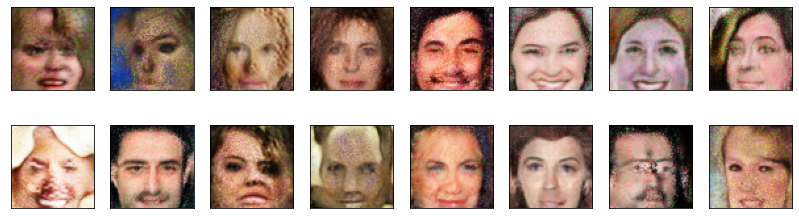

2025-05-16 11:23:47 | Epoch [20/40] | Batch 0/509 | d_loss: 1.2734 | g_loss: 0.8136
2025-05-16 11:24:24 | Epoch [20/40] | Batch 50/509 | d_loss: 1.2955 | g_loss: 0.8375
2025-05-16 11:25:01 | Epoch [20/40] | Batch 100/509 | d_loss: 1.2814 | g_loss: 0.7798
2025-05-16 11:25:38 | Epoch [20/40] | Batch 150/509 | d_loss: 1.3039 | g_loss: 0.8362
2025-05-16 11:26:15 | Epoch [20/40] | Batch 200/509 | d_loss: 1.2887 | g_loss: 0.8607
2025-05-16 11:26:51 | Epoch [20/40] | Batch 250/509 | d_loss: 1.2794 | g_loss: 0.8001
2025-05-16 11:27:28 | Epoch [20/40] | Batch 300/509 | d_loss: 1.3114 | g_loss: 0.8537
2025-05-16 11:28:05 | Epoch [20/40] | Batch 350/509 | d_loss: 1.2726 | g_loss: 0.7836
2025-05-16 11:28:42 | Epoch [20/40] | Batch 400/509 | d_loss: 1.2803 | g_loss: 0.8372
2025-05-16 11:29:19 | Epoch [20/40] | Batch 450/509 | d_loss: 1.2992 | g_loss: 0.7875
2025-05-16 11:29:55 | Epoch [20/40] | Batch 500/509 | d_loss: 1.3050 | g_loss: 0.8250


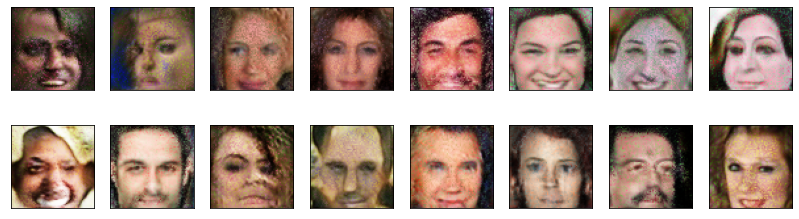

2025-05-16 11:30:06 | Epoch [21/40] | Batch 0/509 | d_loss: 1.2742 | g_loss: 0.7897
2025-05-16 11:30:43 | Epoch [21/40] | Batch 50/509 | d_loss: 1.2753 | g_loss: 0.7673
2025-05-16 11:31:19 | Epoch [21/40] | Batch 100/509 | d_loss: 1.2953 | g_loss: 0.8270
2025-05-16 11:31:56 | Epoch [21/40] | Batch 150/509 | d_loss: 1.3084 | g_loss: 0.8735
2025-05-16 11:32:33 | Epoch [21/40] | Batch 200/509 | d_loss: 1.2853 | g_loss: 0.7851
2025-05-16 11:33:10 | Epoch [21/40] | Batch 250/509 | d_loss: 1.2927 | g_loss: 0.7731
2025-05-16 11:33:47 | Epoch [21/40] | Batch 300/509 | d_loss: 1.2944 | g_loss: 0.7957
2025-05-16 11:34:24 | Epoch [21/40] | Batch 350/509 | d_loss: 1.2642 | g_loss: 0.7934
2025-05-16 11:35:00 | Epoch [21/40] | Batch 400/509 | d_loss: 1.2584 | g_loss: 0.7814
2025-05-16 11:35:37 | Epoch [21/40] | Batch 450/509 | d_loss: 1.3006 | g_loss: 0.8439
2025-05-16 11:36:14 | Epoch [21/40] | Batch 500/509 | d_loss: 1.2855 | g_loss: 0.8645


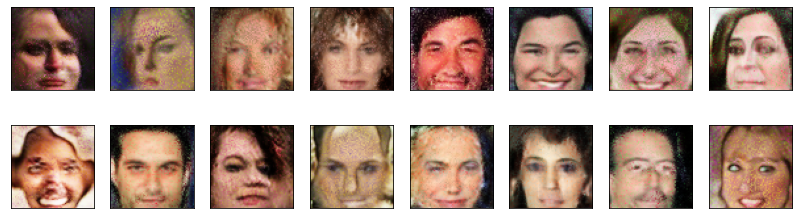

2025-05-16 11:36:24 | Epoch [22/40] | Batch 0/509 | d_loss: 1.2651 | g_loss: 0.7860
2025-05-16 11:37:01 | Epoch [22/40] | Batch 50/509 | d_loss: 1.2895 | g_loss: 0.8099
2025-05-16 11:37:37 | Epoch [22/40] | Batch 100/509 | d_loss: 1.2792 | g_loss: 0.8549
2025-05-16 11:38:14 | Epoch [22/40] | Batch 150/509 | d_loss: 1.2891 | g_loss: 0.7944
2025-05-16 11:38:51 | Epoch [22/40] | Batch 200/509 | d_loss: 1.2897 | g_loss: 0.7887
2025-05-16 11:39:28 | Epoch [22/40] | Batch 250/509 | d_loss: 1.2983 | g_loss: 0.8124
2025-05-16 11:40:05 | Epoch [22/40] | Batch 300/509 | d_loss: 1.2737 | g_loss: 0.8056
2025-05-16 11:40:42 | Epoch [22/40] | Batch 350/509 | d_loss: 1.2931 | g_loss: 0.8155
2025-05-16 11:41:18 | Epoch [22/40] | Batch 400/509 | d_loss: 1.3159 | g_loss: 0.8049
2025-05-16 11:41:55 | Epoch [22/40] | Batch 450/509 | d_loss: 1.2941 | g_loss: 0.8068
2025-05-16 11:42:32 | Epoch [22/40] | Batch 500/509 | d_loss: 1.2981 | g_loss: 0.8737


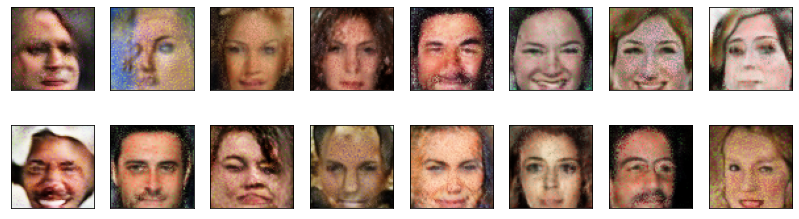

2025-05-16 11:42:43 | Epoch [23/40] | Batch 0/509 | d_loss: 1.2806 | g_loss: 0.8295
2025-05-16 11:43:20 | Epoch [23/40] | Batch 50/509 | d_loss: 1.2755 | g_loss: 0.7947
2025-05-16 11:43:57 | Epoch [23/40] | Batch 100/509 | d_loss: 1.2616 | g_loss: 0.8355
2025-05-16 11:44:33 | Epoch [23/40] | Batch 150/509 | d_loss: 1.3047 | g_loss: 0.8006
2025-05-16 11:45:10 | Epoch [23/40] | Batch 200/509 | d_loss: 1.3016 | g_loss: 0.8077
2025-05-16 11:45:47 | Epoch [23/40] | Batch 250/509 | d_loss: 1.2730 | g_loss: 0.8340
2025-05-16 11:46:24 | Epoch [23/40] | Batch 300/509 | d_loss: 1.2824 | g_loss: 0.7418
2025-05-16 11:47:01 | Epoch [23/40] | Batch 350/509 | d_loss: 1.2886 | g_loss: 0.8142
2025-05-16 11:47:37 | Epoch [23/40] | Batch 400/509 | d_loss: 1.2885 | g_loss: 0.7690
2025-05-16 11:48:14 | Epoch [23/40] | Batch 450/509 | d_loss: 1.2650 | g_loss: 0.8156
2025-05-16 11:48:51 | Epoch [23/40] | Batch 500/509 | d_loss: 1.3097 | g_loss: 0.7970


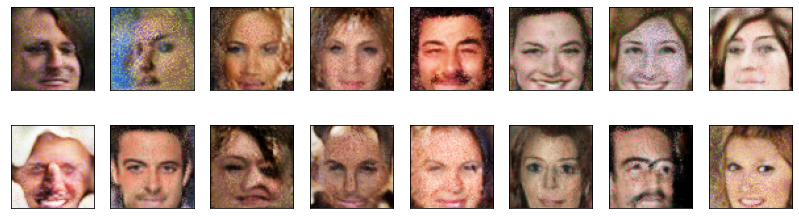

2025-05-16 11:49:01 | Epoch [24/40] | Batch 0/509 | d_loss: 1.2807 | g_loss: 0.7860
2025-05-16 11:49:37 | Epoch [24/40] | Batch 50/509 | d_loss: 1.2950 | g_loss: 0.7796
2025-05-16 11:50:14 | Epoch [24/40] | Batch 100/509 | d_loss: 1.2874 | g_loss: 0.7666
2025-05-16 11:50:51 | Epoch [24/40] | Batch 150/509 | d_loss: 1.2983 | g_loss: 0.7815
2025-05-16 11:51:28 | Epoch [24/40] | Batch 200/509 | d_loss: 1.2888 | g_loss: 0.7877
2025-05-16 11:52:05 | Epoch [24/40] | Batch 250/509 | d_loss: 1.2912 | g_loss: 0.7386
2025-05-16 11:52:41 | Epoch [24/40] | Batch 300/509 | d_loss: 1.2665 | g_loss: 0.8020
2025-05-16 11:53:18 | Epoch [24/40] | Batch 350/509 | d_loss: 1.2900 | g_loss: 0.8415
2025-05-16 11:53:55 | Epoch [24/40] | Batch 400/509 | d_loss: 1.2865 | g_loss: 0.8247
2025-05-16 11:54:32 | Epoch [24/40] | Batch 450/509 | d_loss: 1.2954 | g_loss: 0.7708
2025-05-16 11:55:09 | Epoch [24/40] | Batch 500/509 | d_loss: 1.2966 | g_loss: 0.8087


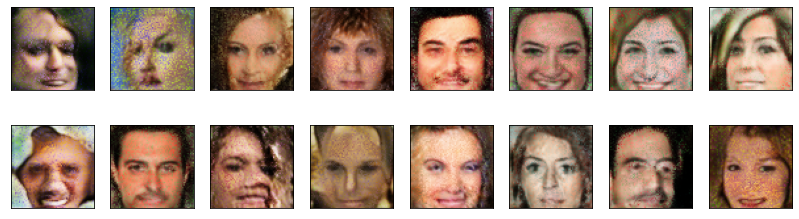

2025-05-16 11:55:18 | Epoch [25/40] | Batch 0/509 | d_loss: 1.2927 | g_loss: 0.8138
2025-05-16 11:55:55 | Epoch [25/40] | Batch 50/509 | d_loss: 1.2992 | g_loss: 0.8533
2025-05-16 11:56:32 | Epoch [25/40] | Batch 100/509 | d_loss: 1.2697 | g_loss: 0.8170
2025-05-16 11:57:08 | Epoch [25/40] | Batch 150/509 | d_loss: 1.2970 | g_loss: 0.7838
2025-05-16 11:57:45 | Epoch [25/40] | Batch 200/509 | d_loss: 1.3026 | g_loss: 0.7973
2025-05-16 11:58:22 | Epoch [25/40] | Batch 250/509 | d_loss: 1.2835 | g_loss: 0.8365
2025-05-16 11:58:59 | Epoch [25/40] | Batch 300/509 | d_loss: 1.3069 | g_loss: 0.7673
2025-05-16 11:59:36 | Epoch [25/40] | Batch 350/509 | d_loss: 1.2984 | g_loss: 0.7794
2025-05-16 12:00:13 | Epoch [25/40] | Batch 400/509 | d_loss: 1.3150 | g_loss: 0.8130
2025-05-16 12:00:49 | Epoch [25/40] | Batch 450/509 | d_loss: 1.3145 | g_loss: 0.7922
2025-05-16 12:01:26 | Epoch [25/40] | Batch 500/509 | d_loss: 1.2934 | g_loss: 0.7867


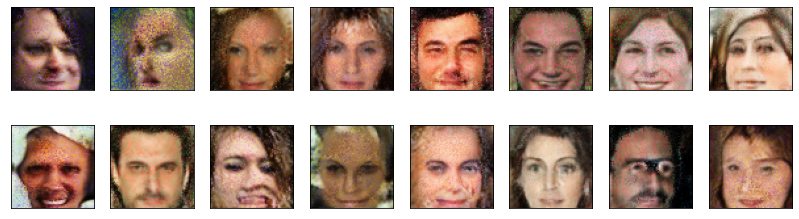

2025-05-16 12:01:36 | Epoch [26/40] | Batch 0/509 | d_loss: 1.2796 | g_loss: 0.8251
2025-05-16 12:02:13 | Epoch [26/40] | Batch 50/509 | d_loss: 1.2984 | g_loss: 0.8387
2025-05-16 12:02:50 | Epoch [26/40] | Batch 100/509 | d_loss: 1.3036 | g_loss: 0.7757
2025-05-16 12:03:27 | Epoch [26/40] | Batch 150/509 | d_loss: 1.2840 | g_loss: 0.8455
2025-05-16 12:04:04 | Epoch [26/40] | Batch 200/509 | d_loss: 1.3011 | g_loss: 0.8218
2025-05-16 12:04:41 | Epoch [26/40] | Batch 250/509 | d_loss: 1.2902 | g_loss: 0.7828
2025-05-16 12:05:17 | Epoch [26/40] | Batch 300/509 | d_loss: 1.3050 | g_loss: 0.7706
2025-05-16 12:05:54 | Epoch [26/40] | Batch 350/509 | d_loss: 1.3037 | g_loss: 0.8474
2025-05-16 12:06:31 | Epoch [26/40] | Batch 400/509 | d_loss: 1.2817 | g_loss: 0.7599
2025-05-16 12:07:08 | Epoch [26/40] | Batch 450/509 | d_loss: 1.2859 | g_loss: 0.7887
2025-05-16 12:07:45 | Epoch [26/40] | Batch 500/509 | d_loss: 1.2934 | g_loss: 0.7510


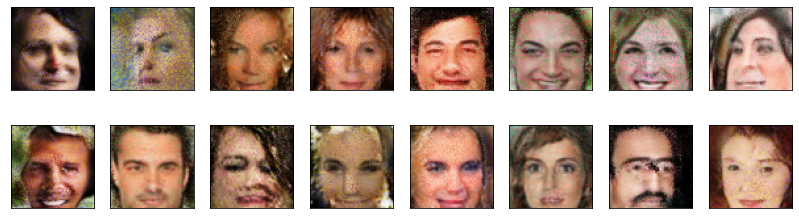

2025-05-16 12:07:55 | Epoch [27/40] | Batch 0/509 | d_loss: 1.2964 | g_loss: 0.7573
2025-05-16 12:08:32 | Epoch [27/40] | Batch 50/509 | d_loss: 1.3062 | g_loss: 0.7760
2025-05-16 12:09:09 | Epoch [27/40] | Batch 100/509 | d_loss: 1.2871 | g_loss: 0.8400
2025-05-16 12:09:45 | Epoch [27/40] | Batch 150/509 | d_loss: 1.3010 | g_loss: 0.7722
2025-05-16 12:10:22 | Epoch [27/40] | Batch 200/509 | d_loss: 1.2905 | g_loss: 0.8659
2025-05-16 12:10:59 | Epoch [27/40] | Batch 250/509 | d_loss: 1.3033 | g_loss: 0.7771
2025-05-16 12:11:36 | Epoch [27/40] | Batch 300/509 | d_loss: 1.3015 | g_loss: 0.7867
2025-05-16 12:12:13 | Epoch [27/40] | Batch 350/509 | d_loss: 1.2775 | g_loss: 0.8074
2025-05-16 12:12:49 | Epoch [27/40] | Batch 400/509 | d_loss: 1.2973 | g_loss: 0.7613
2025-05-16 12:13:26 | Epoch [27/40] | Batch 450/509 | d_loss: 1.3044 | g_loss: 0.7995
2025-05-16 12:14:03 | Epoch [27/40] | Batch 500/509 | d_loss: 1.2924 | g_loss: 0.7793


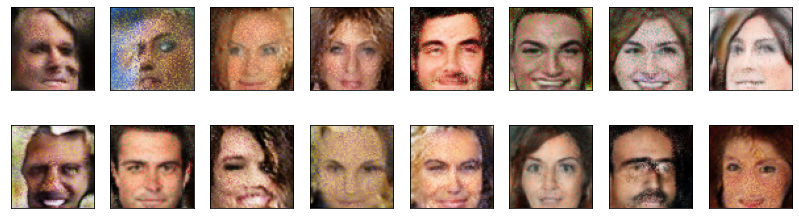

2025-05-16 12:14:14 | Epoch [28/40] | Batch 0/509 | d_loss: 1.2890 | g_loss: 0.7476
2025-05-16 12:14:51 | Epoch [28/40] | Batch 50/509 | d_loss: 1.2977 | g_loss: 0.7793
2025-05-16 12:15:28 | Epoch [28/40] | Batch 100/509 | d_loss: 1.3053 | g_loss: 0.8160
2025-05-16 12:16:05 | Epoch [28/40] | Batch 150/509 | d_loss: 1.2918 | g_loss: 0.8074
2025-05-16 12:16:41 | Epoch [28/40] | Batch 200/509 | d_loss: 1.2949 | g_loss: 0.8110
2025-05-16 12:17:18 | Epoch [28/40] | Batch 250/509 | d_loss: 1.3086 | g_loss: 0.8411
2025-05-16 12:17:55 | Epoch [28/40] | Batch 300/509 | d_loss: 1.3099 | g_loss: 0.8058
2025-05-16 12:18:32 | Epoch [28/40] | Batch 350/509 | d_loss: 1.3044 | g_loss: 0.8132
2025-05-16 12:19:09 | Epoch [28/40] | Batch 400/509 | d_loss: 1.2842 | g_loss: 0.7748
2025-05-16 12:19:45 | Epoch [28/40] | Batch 450/509 | d_loss: 1.2898 | g_loss: 0.8522
2025-05-16 12:20:22 | Epoch [28/40] | Batch 500/509 | d_loss: 1.2954 | g_loss: 0.7926


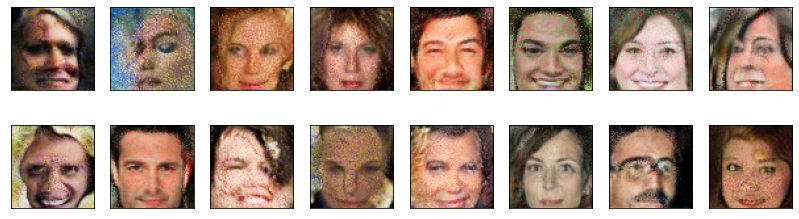

2025-05-16 12:20:32 | Epoch [29/40] | Batch 0/509 | d_loss: 1.2940 | g_loss: 0.8316
2025-05-16 12:21:09 | Epoch [29/40] | Batch 50/509 | d_loss: 1.3166 | g_loss: 0.8548
2025-05-16 12:21:45 | Epoch [29/40] | Batch 100/509 | d_loss: 1.2989 | g_loss: 0.8878
2025-05-16 12:22:22 | Epoch [29/40] | Batch 150/509 | d_loss: 1.3041 | g_loss: 0.8040
2025-05-16 12:22:59 | Epoch [29/40] | Batch 200/509 | d_loss: 1.2987 | g_loss: 0.7218
2025-05-16 12:23:36 | Epoch [29/40] | Batch 250/509 | d_loss: 1.3237 | g_loss: 0.8201
2025-05-16 12:24:13 | Epoch [29/40] | Batch 300/509 | d_loss: 1.3041 | g_loss: 0.8168
2025-05-16 12:24:50 | Epoch [29/40] | Batch 350/509 | d_loss: 1.2957 | g_loss: 0.7523
2025-05-16 12:25:26 | Epoch [29/40] | Batch 400/509 | d_loss: 1.3240 | g_loss: 0.8834
2025-05-16 12:26:03 | Epoch [29/40] | Batch 450/509 | d_loss: 1.2862 | g_loss: 0.7744
2025-05-16 12:26:40 | Epoch [29/40] | Batch 500/509 | d_loss: 1.3028 | g_loss: 0.7878


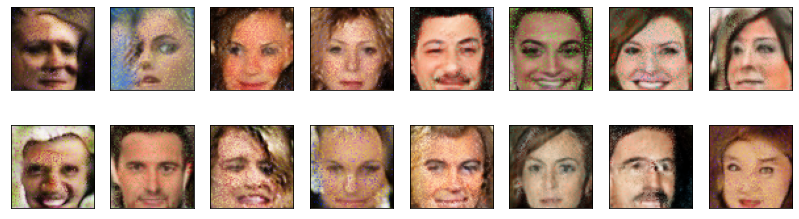

2025-05-16 12:26:50 | Epoch [30/40] | Batch 0/509 | d_loss: 1.2911 | g_loss: 0.8410
2025-05-16 12:27:27 | Epoch [30/40] | Batch 50/509 | d_loss: 1.3066 | g_loss: 0.7735
2025-05-16 12:28:04 | Epoch [30/40] | Batch 100/509 | d_loss: 1.3230 | g_loss: 0.8310
2025-05-16 12:28:41 | Epoch [30/40] | Batch 150/509 | d_loss: 1.3190 | g_loss: 0.7831
2025-05-16 12:29:18 | Epoch [30/40] | Batch 200/509 | d_loss: 1.2970 | g_loss: 0.8129
2025-05-16 12:29:54 | Epoch [30/40] | Batch 250/509 | d_loss: 1.2756 | g_loss: 0.8219
2025-05-16 12:30:31 | Epoch [30/40] | Batch 300/509 | d_loss: 1.3041 | g_loss: 0.7689
2025-05-16 12:31:08 | Epoch [30/40] | Batch 350/509 | d_loss: 1.3166 | g_loss: 0.7895
2025-05-16 12:31:45 | Epoch [30/40] | Batch 400/509 | d_loss: 1.3012 | g_loss: 0.7887
2025-05-16 12:32:22 | Epoch [30/40] | Batch 450/509 | d_loss: 1.2906 | g_loss: 0.7883
2025-05-16 12:32:58 | Epoch [30/40] | Batch 500/509 | d_loss: 1.3196 | g_loss: 0.7961


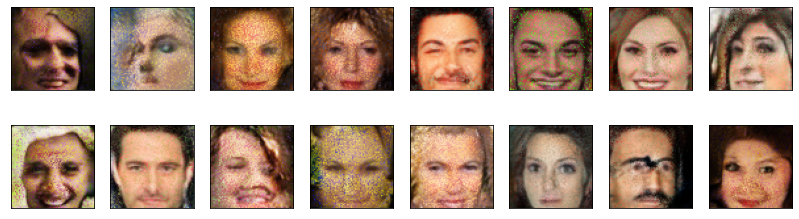

2025-05-16 12:33:08 | Epoch [31/40] | Batch 0/509 | d_loss: 1.3025 | g_loss: 0.7186
2025-05-16 12:33:45 | Epoch [31/40] | Batch 50/509 | d_loss: 1.2900 | g_loss: 0.7660
2025-05-16 12:34:22 | Epoch [31/40] | Batch 100/509 | d_loss: 1.2834 | g_loss: 0.8108
2025-05-16 12:34:59 | Epoch [31/40] | Batch 150/509 | d_loss: 1.2900 | g_loss: 0.7958
2025-05-16 12:35:36 | Epoch [31/40] | Batch 200/509 | d_loss: 1.3126 | g_loss: 0.7590
2025-05-16 12:36:13 | Epoch [31/40] | Batch 250/509 | d_loss: 1.2828 | g_loss: 0.7953
2025-05-16 12:36:49 | Epoch [31/40] | Batch 300/509 | d_loss: 1.3224 | g_loss: 0.7667
2025-05-16 12:37:26 | Epoch [31/40] | Batch 350/509 | d_loss: 1.2874 | g_loss: 0.7755
2025-05-16 12:38:03 | Epoch [31/40] | Batch 400/509 | d_loss: 1.3022 | g_loss: 0.8375
2025-05-16 12:38:40 | Epoch [31/40] | Batch 450/509 | d_loss: 1.3079 | g_loss: 0.7752
2025-05-16 12:39:17 | Epoch [31/40] | Batch 500/509 | d_loss: 1.3201 | g_loss: 0.7837


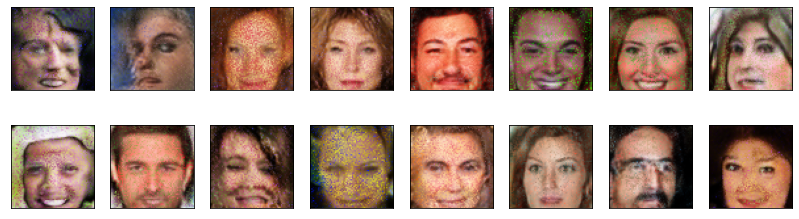

2025-05-16 12:39:27 | Epoch [32/40] | Batch 0/509 | d_loss: 1.3076 | g_loss: 0.8007
2025-05-16 12:40:03 | Epoch [32/40] | Batch 50/509 | d_loss: 1.2850 | g_loss: 0.7928
2025-05-16 12:40:40 | Epoch [32/40] | Batch 100/509 | d_loss: 1.2856 | g_loss: 0.8169
2025-05-16 12:41:17 | Epoch [32/40] | Batch 150/509 | d_loss: 1.2883 | g_loss: 0.8219
2025-05-16 12:41:54 | Epoch [32/40] | Batch 200/509 | d_loss: 1.2973 | g_loss: 0.8246
2025-05-16 12:42:31 | Epoch [32/40] | Batch 250/509 | d_loss: 1.3044 | g_loss: 0.7588
2025-05-16 12:43:07 | Epoch [32/40] | Batch 300/509 | d_loss: 1.2890 | g_loss: 0.7650
2025-05-16 12:43:44 | Epoch [32/40] | Batch 350/509 | d_loss: 1.2794 | g_loss: 0.7982
2025-05-16 12:44:21 | Epoch [32/40] | Batch 400/509 | d_loss: 1.2971 | g_loss: 0.8146
2025-05-16 12:44:58 | Epoch [32/40] | Batch 450/509 | d_loss: 1.3055 | g_loss: 0.8215
2025-05-16 12:45:35 | Epoch [32/40] | Batch 500/509 | d_loss: 1.3108 | g_loss: 0.7967


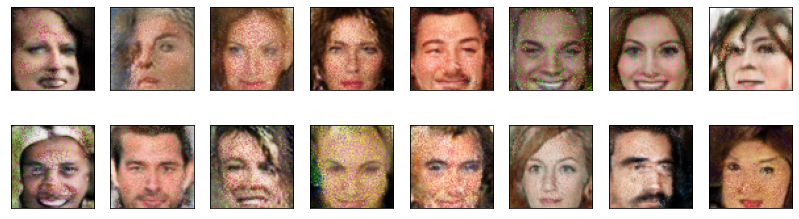

2025-05-16 12:45:44 | Epoch [33/40] | Batch 0/509 | d_loss: 1.3045 | g_loss: 0.7845
2025-05-16 12:46:21 | Epoch [33/40] | Batch 50/509 | d_loss: 1.2958 | g_loss: 0.7661
2025-05-16 12:46:58 | Epoch [33/40] | Batch 100/509 | d_loss: 1.2952 | g_loss: 0.7922
2025-05-16 12:47:35 | Epoch [33/40] | Batch 150/509 | d_loss: 1.2972 | g_loss: 0.7379
2025-05-16 12:48:11 | Epoch [33/40] | Batch 200/509 | d_loss: 1.3115 | g_loss: 0.7750
2025-05-16 12:48:48 | Epoch [33/40] | Batch 250/509 | d_loss: 1.3081 | g_loss: 0.8142
2025-05-16 12:49:25 | Epoch [33/40] | Batch 300/509 | d_loss: 1.3061 | g_loss: 0.7977
2025-05-16 12:50:02 | Epoch [33/40] | Batch 350/509 | d_loss: 1.3080 | g_loss: 0.8370
2025-05-16 12:50:39 | Epoch [33/40] | Batch 400/509 | d_loss: 1.3000 | g_loss: 0.7936
2025-05-16 12:51:16 | Epoch [33/40] | Batch 450/509 | d_loss: 1.3148 | g_loss: 0.7918
2025-05-16 12:51:52 | Epoch [33/40] | Batch 500/509 | d_loss: 1.3002 | g_loss: 0.7785


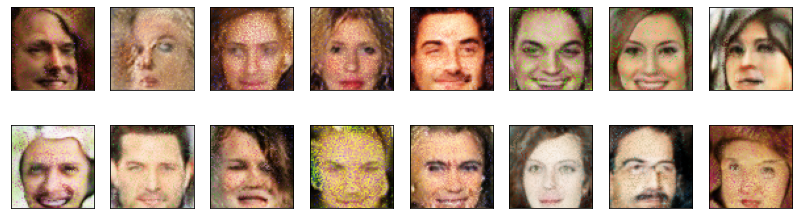

2025-05-16 12:52:02 | Epoch [34/40] | Batch 0/509 | d_loss: 1.3025 | g_loss: 0.8099
2025-05-16 12:52:39 | Epoch [34/40] | Batch 50/509 | d_loss: 1.3113 | g_loss: 0.8176
2025-05-16 12:53:16 | Epoch [34/40] | Batch 100/509 | d_loss: 1.3046 | g_loss: 0.7796
2025-05-16 12:53:52 | Epoch [34/40] | Batch 150/509 | d_loss: 1.2903 | g_loss: 0.7832
2025-05-16 12:54:29 | Epoch [34/40] | Batch 200/509 | d_loss: 1.3012 | g_loss: 0.7770
2025-05-16 12:55:06 | Epoch [34/40] | Batch 250/509 | d_loss: 1.3006 | g_loss: 0.7977
2025-05-16 12:55:43 | Epoch [34/40] | Batch 300/509 | d_loss: 1.2977 | g_loss: 0.7960
2025-05-16 12:56:20 | Epoch [34/40] | Batch 350/509 | d_loss: 1.2872 | g_loss: 0.7786
2025-05-16 12:56:56 | Epoch [34/40] | Batch 400/509 | d_loss: 1.3087 | g_loss: 0.7947
2025-05-16 12:57:33 | Epoch [34/40] | Batch 450/509 | d_loss: 1.2945 | g_loss: 0.7279
2025-05-16 12:58:10 | Epoch [34/40] | Batch 500/509 | d_loss: 1.2950 | g_loss: 0.8083


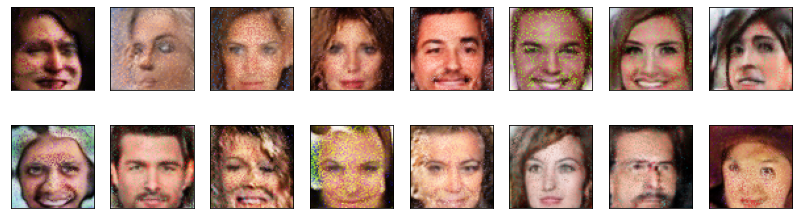

2025-05-16 12:58:20 | Epoch [35/40] | Batch 0/509 | d_loss: 1.2923 | g_loss: 0.7364
2025-05-16 12:58:57 | Epoch [35/40] | Batch 50/509 | d_loss: 1.2941 | g_loss: 0.7420
2025-05-16 12:59:34 | Epoch [35/40] | Batch 100/509 | d_loss: 1.3023 | g_loss: 0.8085
2025-05-16 13:00:11 | Epoch [35/40] | Batch 150/509 | d_loss: 1.2945 | g_loss: 0.8168
2025-05-16 13:00:48 | Epoch [35/40] | Batch 200/509 | d_loss: 1.2989 | g_loss: 0.7182
2025-05-16 13:01:24 | Epoch [35/40] | Batch 250/509 | d_loss: 1.3008 | g_loss: 0.7789
2025-05-16 13:02:01 | Epoch [35/40] | Batch 300/509 | d_loss: 1.3114 | g_loss: 0.7994
2025-05-16 13:02:38 | Epoch [35/40] | Batch 350/509 | d_loss: 1.2986 | g_loss: 0.7697
2025-05-16 13:03:15 | Epoch [35/40] | Batch 400/509 | d_loss: 1.2801 | g_loss: 0.7558
2025-05-16 13:03:52 | Epoch [35/40] | Batch 450/509 | d_loss: 1.3200 | g_loss: 0.8398
2025-05-16 13:04:29 | Epoch [35/40] | Batch 500/509 | d_loss: 1.3076 | g_loss: 0.8197


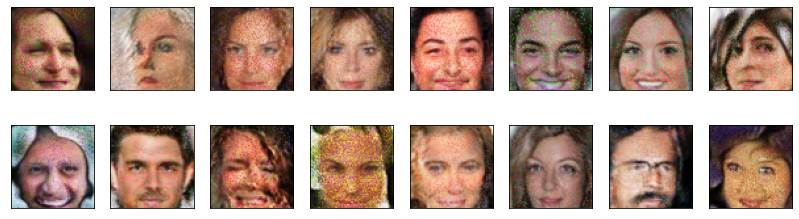

2025-05-16 13:04:39 | Epoch [36/40] | Batch 0/509 | d_loss: 1.3016 | g_loss: 0.8274
2025-05-16 13:05:16 | Epoch [36/40] | Batch 50/509 | d_loss: 1.2883 | g_loss: 0.7264
2025-05-16 13:05:52 | Epoch [36/40] | Batch 100/509 | d_loss: 1.3100 | g_loss: 0.8589
2025-05-16 13:06:29 | Epoch [36/40] | Batch 150/509 | d_loss: 1.3075 | g_loss: 0.7980
2025-05-16 13:07:06 | Epoch [36/40] | Batch 200/509 | d_loss: 1.3114 | g_loss: 0.8074
2025-05-16 13:07:43 | Epoch [36/40] | Batch 250/509 | d_loss: 1.2763 | g_loss: 0.7571
2025-05-16 13:08:20 | Epoch [36/40] | Batch 300/509 | d_loss: 1.3300 | g_loss: 0.8242
2025-05-16 13:08:56 | Epoch [36/40] | Batch 350/509 | d_loss: 1.3107 | g_loss: 0.8112
2025-05-16 13:09:33 | Epoch [36/40] | Batch 400/509 | d_loss: 1.3053 | g_loss: 0.8232
2025-05-16 13:10:10 | Epoch [36/40] | Batch 450/509 | d_loss: 1.3100 | g_loss: 0.8212
2025-05-16 13:10:47 | Epoch [36/40] | Batch 500/509 | d_loss: 1.3064 | g_loss: 0.7535


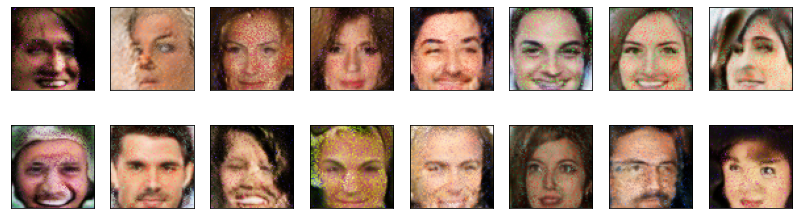

2025-05-16 13:10:57 | Epoch [37/40] | Batch 0/509 | d_loss: 1.3083 | g_loss: 0.8026
2025-05-16 13:11:34 | Epoch [37/40] | Batch 50/509 | d_loss: 1.2933 | g_loss: 0.7709
2025-05-16 13:12:11 | Epoch [37/40] | Batch 100/509 | d_loss: 1.3126 | g_loss: 0.7715
2025-05-16 13:12:48 | Epoch [37/40] | Batch 150/509 | d_loss: 1.3260 | g_loss: 0.8064
2025-05-16 13:13:25 | Epoch [37/40] | Batch 200/509 | d_loss: 1.3052 | g_loss: 0.7987
2025-05-16 13:14:02 | Epoch [37/40] | Batch 250/509 | d_loss: 1.3211 | g_loss: 0.7978
2025-05-16 13:14:38 | Epoch [37/40] | Batch 300/509 | d_loss: 1.3201 | g_loss: 0.8239
2025-05-16 13:15:15 | Epoch [37/40] | Batch 350/509 | d_loss: 1.3175 | g_loss: 0.7250
2025-05-16 13:15:52 | Epoch [37/40] | Batch 400/509 | d_loss: 1.3104 | g_loss: 0.8625
2025-05-16 13:16:29 | Epoch [37/40] | Batch 450/509 | d_loss: 1.3168 | g_loss: 0.7522
2025-05-16 13:17:06 | Epoch [37/40] | Batch 500/509 | d_loss: 1.3101 | g_loss: 0.8197


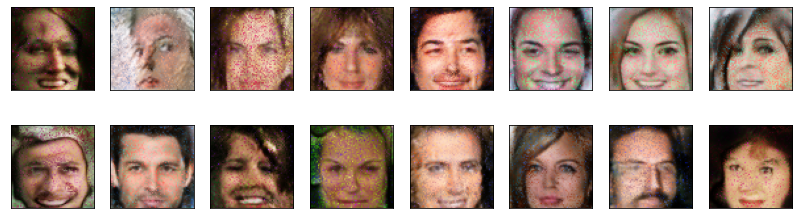

2025-05-16 13:17:16 | Epoch [38/40] | Batch 0/509 | d_loss: 1.2993 | g_loss: 0.7602
2025-05-16 13:17:53 | Epoch [38/40] | Batch 50/509 | d_loss: 1.3092 | g_loss: 0.7666
2025-05-16 13:18:29 | Epoch [38/40] | Batch 100/509 | d_loss: 1.3072 | g_loss: 0.7760
2025-05-16 13:19:06 | Epoch [38/40] | Batch 150/509 | d_loss: 1.3080 | g_loss: 0.8251
2025-05-16 13:19:43 | Epoch [38/40] | Batch 200/509 | d_loss: 1.2823 | g_loss: 0.8041
2025-05-16 13:20:20 | Epoch [38/40] | Batch 250/509 | d_loss: 1.2892 | g_loss: 0.7732
2025-05-16 13:20:57 | Epoch [38/40] | Batch 300/509 | d_loss: 1.3111 | g_loss: 0.7586
2025-05-16 13:21:33 | Epoch [38/40] | Batch 350/509 | d_loss: 1.3213 | g_loss: 0.8231
2025-05-16 13:22:10 | Epoch [38/40] | Batch 400/509 | d_loss: 1.3138 | g_loss: 0.7800
2025-05-16 13:22:47 | Epoch [38/40] | Batch 450/509 | d_loss: 1.3313 | g_loss: 0.8304
2025-05-16 13:23:24 | Epoch [38/40] | Batch 500/509 | d_loss: 1.2997 | g_loss: 0.7581


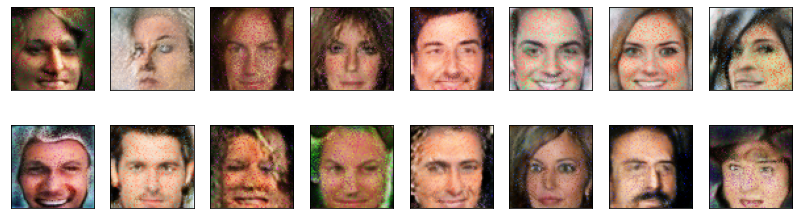

2025-05-16 13:23:34 | Epoch [39/40] | Batch 0/509 | d_loss: 1.2999 | g_loss: 0.8264
2025-05-16 13:24:11 | Epoch [39/40] | Batch 50/509 | d_loss: 1.3038 | g_loss: 0.7899
2025-05-16 13:24:48 | Epoch [39/40] | Batch 100/509 | d_loss: 1.2821 | g_loss: 0.7819
2025-05-16 13:25:24 | Epoch [39/40] | Batch 150/509 | d_loss: 1.3074 | g_loss: 0.7975
2025-05-16 13:26:01 | Epoch [39/40] | Batch 200/509 | d_loss: 1.2939 | g_loss: 0.8362
2025-05-16 13:26:38 | Epoch [39/40] | Batch 250/509 | d_loss: 1.2987 | g_loss: 0.8123
2025-05-16 13:27:15 | Epoch [39/40] | Batch 300/509 | d_loss: 1.2939 | g_loss: 0.7695
2025-05-16 13:27:52 | Epoch [39/40] | Batch 350/509 | d_loss: 1.3063 | g_loss: 0.7470
2025-05-16 13:28:28 | Epoch [39/40] | Batch 400/509 | d_loss: 1.2882 | g_loss: 0.7420
2025-05-16 13:29:05 | Epoch [39/40] | Batch 450/509 | d_loss: 1.3116 | g_loss: 0.8083
2025-05-16 13:29:42 | Epoch [39/40] | Batch 500/509 | d_loss: 1.3048 | g_loss: 0.7831


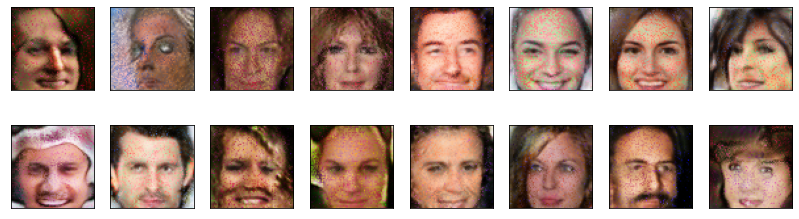

2025-05-16 13:29:52 | Epoch [40/40] | Batch 0/509 | d_loss: 1.2990 | g_loss: 0.7600
2025-05-16 13:30:28 | Epoch [40/40] | Batch 50/509 | d_loss: 1.3148 | g_loss: 0.7875
2025-05-16 13:31:05 | Epoch [40/40] | Batch 100/509 | d_loss: 1.3032 | g_loss: 0.8046
2025-05-16 13:31:42 | Epoch [40/40] | Batch 150/509 | d_loss: 1.3035 | g_loss: 0.7773
2025-05-16 13:32:19 | Epoch [40/40] | Batch 200/509 | d_loss: 1.3150 | g_loss: 0.7640
2025-05-16 13:32:56 | Epoch [40/40] | Batch 250/509 | d_loss: 1.3175 | g_loss: 0.7270
2025-05-16 13:33:32 | Epoch [40/40] | Batch 300/509 | d_loss: 1.3224 | g_loss: 0.8625
2025-05-16 13:34:09 | Epoch [40/40] | Batch 350/509 | d_loss: 1.3008 | g_loss: 0.7356
2025-05-16 13:34:46 | Epoch [40/40] | Batch 400/509 | d_loss: 1.3136 | g_loss: 0.8086
2025-05-16 13:35:23 | Epoch [40/40] | Batch 450/509 | d_loss: 1.3005 | g_loss: 0.7365
2025-05-16 13:36:00 | Epoch [40/40] | Batch 500/509 | d_loss: 1.3138 | g_loss: 0.8125


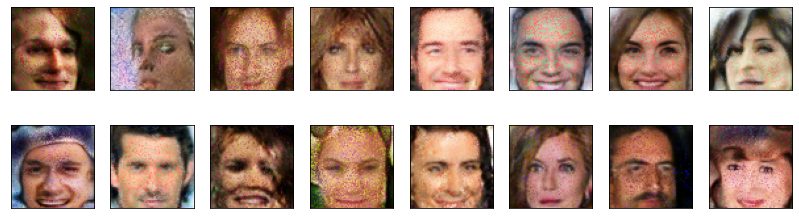

In [41]:
fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).float().cuda()
noise_std = 0.1
losses = []
for epoch in range(n_epochs):
    for batch_i, real_images in enumerate(dataloader):
        real_images = real_images.to(device)
        noise = torch.randn_like(real_images) * noise_std
        noisy_real_images = real_images + noise
        dis_step_out = discriminator_step(batch_size, latent_dim, noisy_real_images)
        dis_step_out = discriminator_step(batch_size, latent_dim, noisy_real_images)
        d_loss = dis_step_out["loss"]
        
        gen_step_out = generator_step(batch_size, latent_dim)
        gen_step_out = generator_step(batch_size, latent_dim)
        g_loss = gen_step_out["loss"]
        
        
        
        if batch_i % print_every == 0:
            losses.append((d_loss.item(), g_loss.item()))
            time = str(datetime.now()).split('.')[0]
            print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d_loss.item():.4f} | g_loss: {g_loss.item():.4f}')
    
    generator.eval()
    generated_images = generator(fixed_latent_vector)
    display(generated_images)
    generator.train()


### Training losses

Plot the training losses for the generator and discriminator.

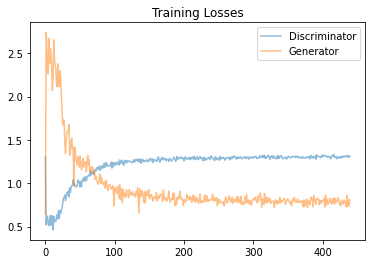

In [42]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

### Question: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* The dataset is biased; it is made of "celebrity" faces that are mostly white
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result
* Loss functions

**Answer:** First of all, I noticed that the generated samples tend to have a portion of the sides and the top of the image reserved for the hair, even if the generated face is likely to be a man's face, and may be that happened because the majority of the images are faces of women with long blonde hair. Secondly, I tried to regularize the discriminator by introducing some noise in the real images, but that could've affected the learning process of the generator since it learned some of the noise too. Lastly, I would try a more complex model, but for the current time my knowledge in GANs ends here, but I will learn more as soon as possible and I could try to use my model on a larger dataset that is class-balanced (male: 50%, female: 50%).

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb".  

Submit the notebook using the ***SUBMIT*** button in the bottom right corner of the Project Workspace.